# Building ML NLP model on Amazon Recommendation Dataset





###**Objective:**
The purpose of the project is to do basic Exploratory Data Analysis (EDA) and make prediction based on reviews as whether the review is Positive or Negative.

###**Source:**
I will work on Amazon's Fine Food Reviews dataset which is available on [Kaggle](https://kaggle.com) 
This dataset consists of reviews of fine foods from Amazon. The data span a period of more than 10 years, including all ~500,000 reviews up to October 2012. Reviews include product and user information, ratings, and a plain text review. It also includes reviews from all other Amazon categories.

Data includes:
- Reviews from Oct 1999 - Oct 2012
- 568,454 reviews
- 256,059 users
- 74,258 products
- 260 users with > 50 reviews

In [0]:
import sqlite3
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import re
from collections import defaultdict

# nlp
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
from nltk.corpus import stopwords
stop = stopwords.words('english')

from nltk.stem import PorterStemmer, SnowballStemmer
from nltk.tokenize import word_tokenize



# data preparation
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, GridSearchCV, KFold
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn.metrics import confusion_matrix
from imblearn.under_sampling import RandomUnderSampler
from wordcloud import STOPWORDS

# algorithms
from sklearn import linear_model, ensemble
from sklearn.neural_network import MLPClassifier
import xgboost as xgb

# evaluation
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, roc_curve, average_precision_score, classification_report
from sklearn.metrics import precision_recall_curve, recall_score, precision_score, f1_score

import warnings
warnings.filterwarnings('ignore')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### Setting-up Plotly

In [0]:
# plotly
from plotly import tools
import plotly.offline as py
import plotly.graph_objs as go

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

### Import Data from Kaggle API into Colab


In [0]:
# import json file into colab
from google.colab import files
files.upload()

# setup Kaggle DIR; copy json file ; chmod
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!ls ~/.kaggle

# verifying json file content
!ls -l ~/.kaggle
!cat ~/.kaggle/kaggle.json


Saving kaggle.json to kaggle.json
kaggle.json
total 4
-rw------- 1 root root 64 Jul 18 03:04 kaggle.json
{"username":"hafeez13","key":"f8f4ff99e0d6a812fd6a8fc27d6238d4"}

In [0]:
!kaggle datasets list -s Amazon

ref                                                        title                                               size  lastUpdated          downloadCount  
---------------------------------------------------------  -------------------------------------------------  -----  -------------------  -------------  
snap/amazon-fine-food-reviews                              Amazon Fine Food Reviews                           251MB  2017-05-01 18:51:31          45743  
sid321axn/amazon-alexa-reviews                             Amazon Alexa Reviews                               164KB  2018-07-31 17:45:14           4308  
bittlingmayer/amazonreviews                                Amazon Reviews for Sentiment Analysis              493MB  2017-05-24 13:05:13          15185  
PromptCloudHQ/amazon-reviews-unlocked-mobile-phones        Amazon Reviews: Unlocked Mobile Phones              35MB  2017-01-11 10:22:30           5354  
datafiniti/consumer-reviews-of-amazon-products             Consumer Reviews 

In [0]:
# Amazon related datasets on Kaggle
!kaggle datasets download -d snap/amazon-fine-food-reviews

 97% 243M/251M [00:05<00:00, 33.1MB/s]
100% 251M/251M [00:05<00:00, 45.1MB/s]


In [20]:
# download the dataset
!kaggle datasets download -d snap/amazon-fine-food-reviews
!unzip \*.zip

amazon-fine-food-reviews.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  amazon-fine-food-reviews.zip
replace Reviews.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: Reviews.csv             
replace database.sqlite? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: database.sqlite         y

replace hashes.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename:   inflating: hashes.txt              


To decrease the computational cost, we will use the SQLITE dataset where I will only fetch the Score and the recommendation summary. Recommendation summary is the shortened version of the product reviews.



In [21]:
# reading data from sqlite file
con = sqlite3.connect('database.sqlite')

df = pd.read_sql_query("""
SELECT 
  Score, 
  Summary, 
  HelpfulnessDenominator as TotalVotes
FROM Reviews""", con)

df.head()

,Score,Summary,TotalVotes
0,5,Good Quality Dog Food,1
1,1,Not as Advertised,0
2,4,"""Delight"" says it all",1
3,2,Cough Medicine,3
4,5,Great taffy,0


In [22]:
df.Score.value_counts()

5    363122
4     80655
1     52268
3     42640
2     29769
Name: Score, dtype: int64

### Creating Target Variable
As we only need to get the global sentiment of the recommendations (positive or negative), I will intentionally ignore all Scores equal to 3. If the score is above 3, then the recommendation will be set to "postive". Otherwise, it will be set to "negative".

In [23]:
# creating Sentiment column
df['Sentiment'] = np.where(df['Score'] > 3, 'positive', 'negative')
df.Sentiment.head()

0    positive
1    negative
2    positive
3    negative
4    positive
Name: Sentiment, dtype: object

In [0]:
# custom function to plot
def plot_Bar(x, y, text, title, filename, color, orientation = None):
  configure_plotly_browser_state()
  py.init_notebook_mode(connected=False)
  
  
  data = [go.Bar(x = x, y = y, orientation = orientation, marker= dict(colorscale='Viridis', color = color), text = text)]

  layout = go.Layout(title = title)

  fig = go.Figure(data=data, layout=layout)

  py.iplot(fig, filename=filename)

#1.  Exploratory Analysis (EDA/VEDA)

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 4 columns):
Score         568454 non-null int64
Summary       568454 non-null object
TotalVotes    568454 non-null int64
Sentiment     568454 non-null object
dtypes: int64(2), object(2)
memory usage: 17.3+ MB


In [26]:
df.describe()

,Score,TotalVotes
count,568454.000000,568454.00000
mean,4.183199,2.22881
std,1.310436,8.28974
min,1.000000,0.00000
25%,4.000000,0.00000
50%,5.000000,1.00000
75%,5.000000,2.00000
max,5.000000,923.00000


The dataset has 568.454 rows and 4 columns. There is no missing values which is good. 

### Distribution of *'Score'*

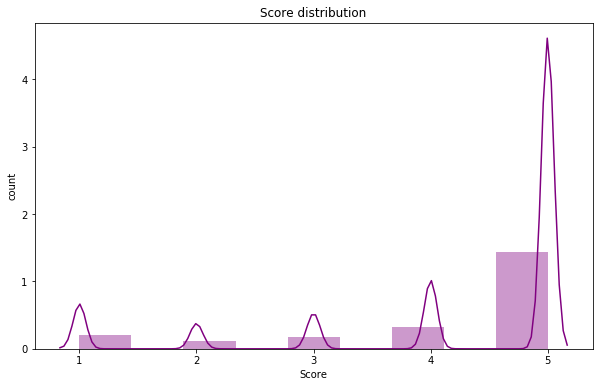

In [27]:
# Score distribution
plt.figure(figsize = (10,6))
_ = sns.distplot(df['Score'], bins = 9, color = 'purple')
_.set(xlabel = 'Score', ylabel = 'count', title = 'Score distribution')
plt.show()

From **`Score`** distribution, we can forecast that our outcome varibale distribution will be inbalanced. Most of reviews are scored 4 and above. 

### Target Distribution
Let's look at the distribution of target variable.

In [28]:
target_cnt = df['Sentiment'].value_counts()
x = target_cnt.index
y = target_cnt.values

# plot target distribution
plot_Bar(x, y, 'sentiment counts', 'Target Distribution', 'TargetDistribution', color = y)

target = df.Sentiment.value_counts(normalize = True).round(4)*100
print('Target distribution percentage:\n', target, '\n')

Target distribution percentage:
 positive    78.07
negative    21.93
Name: Sentiment, dtype: float64 



Outcome variable distribution is imbalanced. By undersampling, we'll see if the class imbalance is critical.

---


**Let see examples of positive sentiment**

In [29]:
df[df['Sentiment'] == 'positive'].head()

,Score,Summary,TotalVotes,Sentiment
0,5,Good Quality Dog Food,1,positive
2,4,"""Delight"" says it all",1,positive
4,5,Great taffy,0,positive
5,4,Nice Taffy,0,positive
6,5,Great! Just as good as the expensive brands!,0,positive


**What about negative reviews?**


In [30]:
df[df['Sentiment'] == 'negative'].head()

,Score,Summary,TotalVotes,Sentiment
1,1,Not as Advertised,0,negative
3,2,Cough Medicine,3,negative
12,1,My Cats Are Not Fans of the New Food,1,negative
16,2,poor taste,0,negative
26,1,Nasty No flavor,1,negative


# NLP: Data Preprocessing
Data preprocessing refers to the transformations applied to the data before feeding it to the algorithm. As a first step I'll remove special characters from the Summary and make it all lowercase.

In [31]:
def text_preprocess(text):
    # all text to lowercase
    lower_text = text.lower()
    no_apostrophe = lower_text.replace("'", "")
    # remove special characters
    clean_text = re.sub('[^a-zA-Z]', ' ', no_apostrophe)
    return clean_text


df['summary_cleaned'] = df['Summary'].map(lambda text: text_preprocess(text)) 
df['summary_cleaned'].head()

0    good quality dog food
1        not as advertised
2     delight  says it all
3           cough medicine
4              great taffy
Name: summary_cleaned, dtype: object

## Removing StopWords
Stopwords are the words that we would not want them taking up space in the dataset. They take up processing time and by ignoring them we can work efficiently. 

I will remove the stopwords from the Summary using the Wordcloud package.


In [32]:
# removing stop words
df['summary_cleaned'] = df['summary_cleaned'].apply(lambda word: ' '.join(word for word in word.split() if word not in stop))
df.summary_cleaned.head()

0    good quality dog food
1               advertised
2             delight says
3           cough medicine
4              great taffy
Name: summary_cleaned, dtype: object

In [33]:
#@title
# positive and negative word count before text processing
pos_words = df[df['Sentiment'] == 'positive'][['Summary']]
neg_words = df[df['Sentiment'] == 'negative'][['Summary']]

# positive and negative word count after text processing
pos_words_clean = df[df['Sentiment'] == 'positive'][['summary_cleaned']]
neg_words_clean = df[df['Sentiment'] == 'negative'][['summary_cleaned']]

print("Number of original Positive words: {0} words\n"
      "Number of original Positive words after stopwords removal: {1} words"
      .format(len(pos_words['Summary'].value_counts()), len(pos_words_clean['summary_cleaned'].value_counts())))

print("=="*46)

print("Number of original Negative words: {0} words\n"
      "Number of original Negative words after stopwords removal: {1} words"
      .format(len(neg_words['Summary'].value_counts()), len(neg_words_clean['summary_cleaned'].value_counts())))


Number of original Positive words: 226294 words
Number of original Positive words after stopwords removal: 177750 words
Number of original Negative words: 71939 words
Number of original Negative words after stopwords removal: 58607 words


## Tokenization
Tokenization is the process of breaking up the given text into units called tokens. The tokens may be words or number or punctuation mark. As we already removed special characters, our tokens will be only words.  We will use word_tokenize method from NLTK to split the review text into individual words .

In [34]:
# tokenizing
df['summary_tokenized'] = df['summary_cleaned'].apply(word_tokenize)
df.summary_tokenized.head()


0    [good, quality, dog, food]
1                  [advertised]
2               [delight, says]
3             [cough, medicine]
4                [great, taffy]
Name: summary_tokenized, dtype: object

## Lemmatisation
In linguistics, lemmatisation is the process of grouping together the inflected forms of a word so they can be analysed as a single item, identified by the word's lemma.

In [35]:
# initializing NLTK lemmatizer
lemmatizer = nltk.stem.WordNetLemmatizer()

# custom function to lemmatize the words
def lemmatize_text(text):
    return [lemmatizer.lemmatize(word) for word in text]

# checking lemmatizer
print("The lemmatized form of Feet is: {}".format(lemmatizer.lemmatize("feet")))

df['lemmatized_words'] = df['summary_tokenized'].apply(lemmatize_text)
df['lemmatized_words'].head()

The lemmatized form of Feet is: foot


0    [good, quality, dog, food]
1                  [advertised]
2                [delight, say]
3             [cough, medicine]
4                [great, taffy]
Name: lemmatized_words, dtype: object

## Word Frequency Distribution

In [36]:
#@title
# freuqently accuring words
words = df['summary_cleaned'].str.split(expand=True).unstack().value_counts()

x = words.index[:25]
y = words.values[:25]
color = y

# plot most accuring words in summary
plot_Bar(y, x, 'word count', 'Frequent Occuring Words in Summary', 'FOW-S', color, orientation = 'h')

In [37]:
# most occuring words in positive sentiment
x_pos = pos_words_clean['summary_cleaned'].str.split(expand=True).unstack().value_counts().index[:25]
y_pos = pos_words_clean['summary_cleaned'].str.split(expand=True).unstack().value_counts().values[:25]
color = y_pos

# plot 
plot_Bar(y_pos, x_pos, 'word count', 'Frequent Occuring Words in Positive Sentiment', 'FOWP-S', color, orientation ='h')


In [38]:
# most occuring words in negtive sentiment
x_neg = neg_words_clean['summary_cleaned'].str.split(expand=True).unstack().value_counts().index[:25]
y_neg = neg_words_clean['summary_cleaned'].str.split(expand=True).unstack().value_counts().values[:25]
color = y_neg

# plot 
plot_Bar(y_neg, x_neg, 'word count', 'Frequent Occuring Words in Negative Sentiment', 'FOWN-S', color, orientation ='h')


### Bigrams
A bigram is a sequence of two adjacent elements from a string of tokens, which are typically letters, syllables, or words. Bigrams carry more information, therefore they may increase the accuracy of the model compated to single tokens.

In [39]:
# bigrams
_pos = df[df['Sentiment']=='positive']
_neg = df[df['Sentiment']=='negative']

# custom function to generate ngram
def gen_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(" ") if token != "" if token not in STOPWORDS]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [" ".join(ngram) for ngram in ngrams]

# custom function for horizontal bar chart 
def horizontal_bar(df, color):
  configure_plotly_browser_state()
  py.init_notebook_mode(connected=False)
  trace = go.Bar(
        y=df["word"].values[::-1],
        x=df["word_count"].values[::-1],
        showlegend=False,
        orientation = 'h',
        marker=dict(color=color))
  return trace

## get the bar chart from positive sentiment
freq_dict = defaultdict(int)
for sent in _pos["summary_cleaned"]:
    for word in gen_ngrams(sent, 2):
        freq_dict[word] += 1       
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "word_count"]
trace_pos = horizontal_bar(fd_sorted.head(25), 'yellow')

# get the bar chart from negative sentiment
freq_dict = defaultdict(int)
for sent in _neg["summary_cleaned"]:
    for word in gen_ngrams(sent, 2):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "word_count"]
trace_neg= horizontal_bar(fd_sorted.head(25), 'purple')

# Creating two subplots
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of Positive sentiment", 
                                          "Frequent words of Negative sentiment"])
fig.append_trace(trace_pos, 1, 1)
fig.append_trace(trace_neg, 1, 2)
fig['layout'].update(height=1200, width=900, paper_bgcolor='rgb(233,233,233)', title="Bigram Plots Positive Vs Negative after removing Stopwords")
py.iplot(fig, filename='bigram-plots')



This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



**Observations**
If we look at the bigrams in negative sentiment, there are some combinations which don't look really **`negative`:**



`taste great`,  `gluten free`,  `good product`,  `great product`,   `good taste`



---

Let see what we can get from Trigrams


### Trigrams
Trigrams are the sequence of three tokens.

In [40]:
# trigrams
# get the bar chart from positive sentiment
freq_dict = defaultdict(int)
for sent in _pos["summary_cleaned"]:
    for word in gen_ngrams(sent, 3):
        freq_dict[word] += 1       
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "word_count"]
trace_pos = horizontal_bar(fd_sorted.head(25), 'yellow')

# get the bar chart from negative sentiment
freq_dict = defaultdict(int)
for sent in _neg["summary_cleaned"]:
    for word in gen_ngrams(sent, 3):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "word_count"]
trace_neg= horizontal_bar(fd_sorted.head(25), 'purple')

# Creating two subplots
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of Positive sentiment", 
                                          "Frequent words of Negative sentiment"])
fig.append_trace(trace_pos, 1, 1)
fig.append_trace(trace_neg, 1, 2)
fig['layout'].update(height=1200, width=900, paper_bgcolor='rgb(233,233,233)', title="Trigram Plots Positive Vs Negative after removing Stopwords")
py.iplot(fig, filename='trigram-plots')



This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



Sequence of three tokens make more sense than bigrams. No sentiment confusion is observed.

# Data Preparation 

In [41]:
from sklearn.preprocessing import LabelEncoder


data = df.copy()
#data = data.sample(frac = 0.35)

X = data.summary_cleaned
data.Sentiment = np.where(data['Sentiment'] == 'positive', 1, 0)
y = data.Sentiment

le = LabelEncoder()
y = le.fit_transform(y)
y = y.reshape(-1,1)

# splitting data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, stratify = y)

print('Train set size: ', X_train.shape)
print('Train set size: ', X_test.shape)
df.head()

Train set size:  (454763,)
Train set size:  (113691,)


,Score,Summary,TotalVotes,Sentiment,summary_cleaned,summary_tokenized,lemmatized_words
0,5,Good Quality Dog Food,1,positive,good quality dog food,"[good, quality, dog, food]","[good, quality, dog, food]"
1,1,Not as Advertised,0,negative,advertised,[advertised],[advertised]
2,4,"""Delight"" says it all",1,positive,delight says,"[delight, says]","[delight, say]"
3,2,Cough Medicine,3,negative,cough medicine,"[cough, medicine]","[cough, medicine]"
4,5,Great taffy,0,positive,great taffy,"[great, taffy]","[great, taffy]"


### Feature Extraction

In [0]:
# Bag of Words
count_vect = CountVectorizer(binary=True, min_df=3, max_df=0.9, max_features=5000, ngram_range = (1, 3))
# Tf-Idf 
tfidf_transformer = TfidfTransformer()

# BoW features
X_train_counts = count_vect.fit_transform(X_train)
X_test_counts = count_vect.transform(X_test)

# Tf-Idf features
X_train_tfidf = tfidf_transformer.fit_transform(X_train_counts)
X_test_tfidf = tfidf_transformer.transform(X_test_counts)


### Undersampling

In [43]:
# initialize Random Undersampler
rus = RandomUnderSampler()

X_train_s, y_train_s = rus.fit_sample(X_train_tfidf, y_train)
X_train_bow_s, y_train_bow_s = rus.fit_sample(X_train_counts, y_train)

count = np.bincount(y_train_s[:, 0])
print('number of negatives\'s {} \nnumber of positives\'s {}'.format(
        count[0], count[1]))

number of negatives's 99742 
number of positives's 99742


# Baseline Models

In [0]:
# creating report dataset to hold the results for later comparison
columns =['Model', 'Dataset', 'Features', 'n_train', 'Cross_Val_Mean', 'Cross_Val_Std', 'Test_Accuracy', 'AUC Score', 'Recall', 'Precision', 'F1']
report  = pd.DataFrame(columns = columns)

In [0]:
from time import time
# define a function to fit and predict ML models
def run_model(model, X_train, y_train, X_test, y_test, i, features, dataset):
    
    """This function gets classification model, its name, training and test
    sets as inputs and returns model's accuracy score thru 5 fold cross-validation.
    The function also calculates Type I & II errors as well as Recal, Precision & F1 scores of the model.
    
    Parameters
    ----------
    mod: classifier
    model_name (str): classifier's name
    X_train: the training data set
    Y_train: the set of labels to all the data in X_train
    X_test: the test data set
    Y_test: the set of labels to all the data in X_test
    
    Returns
    -------
    str:
        model name
    float:
        Type I & Type II errors
    float: 
        Accuracy score
    float:
        5 folds cross-validation accuracy score
    float:
        Recall score
    float:
        Precision score
    float:
        F1 score
    plotted confusion matrix figure   
    
    """
    t0 = time()
    print('\n','-'*40,'\n',model.__class__.__name__,'\n','-'*40)
    model.fit(X_train,y_train)
    y_ = model.predict(X_test)
    
    print('Accuracy Score: ' + str(accuracy_score(y_test, y_)))
    report.loc[i,'Test_Accuracy'] = accuracy_score(y_test, y_)

    # cross validation
    cv = KFold(n_splits=10)
    cvs = cross_val_score(model, X_train, y_train, cv=cv)
    print("10 Folds Cross Validation Score Statistics: %0.5f (+/- %0.5f)" % (cvs.mean(), cvs.std() * 2))
    
    report.loc[i,'Cross_Val_Mean'] = cvs.mean() 
    report.loc[i,'Cross_Val_Std'] = cvs.std()
    report.loc[i,'n_train'] = X_train.shape[0]
    report.loc[i,'Recall'] = recall_score(y_test, y_)
    report.loc[i,'Precision'] = precision_score(y_test, y_)
    report.loc[i,'F1'] = f1_score(y_test, y_)
    report.loc[i,'Model'] = model.__class__.__name__
    report.loc[i, 'Features'] = features
    report.loc[i, 'Dataset'] = dataset
    
    # accuracy tables.
    table_acc = confusion_matrix(y_test, y_)
    #table_acc = pd.crosstab(Y_test, Y_, margins=True)
    
    print(classification_report(y_test, y_, target_names=['positive', 'negative']))

    f, ax = plt.subplots(figsize =(5,5))
    sns.heatmap(table_acc, annot = True, linewidths=0.5, cmap = 'YlGnBu',fmt = ".0f", ax=ax)
    plt.title("Confusion Matrix")
    plt.xlabel("predicted Y values")
    plt.ylabel("actual Y values")
    plt.show()
    print(time() - t0, 'seconds')


In [0]:
# define a function to calculate and plot ROC curve
def run_roc_auc(model, model_name, X_test, y_test, i):
    
    """The module gets classification model, its name and test
    sets as inputs and returns the plotted ROC cure for specific model.
    
    Parameters
    ----------
    mod: classifier
    model_name (str): classifier's name
    X_test: the test data set
    Y_test: the set of labels to all the data in X_test
    
    Returns
    -------
    plotted ROC curve 
    
    """
    cv = KFold(n_splits=5)
    #mod_predict = cross_val_predict(model, X_train, y_train, cv = cv)    
    # calculate roc curve
    mod_fpr, mod_tpr, mod_threshold = roc_curve(y_test, model.predict_proba(X_test)[:,1])
    
    # plot roc curve
    plt.figure(figsize=(10,16))
    plt.subplot(211)
    plt.title('ROC curve for '+ model_name, fontsize=14)
    plt.plot(mod_fpr, mod_tpr, label= model_name + ' AUC Score: {:.4f}'.format(roc_auc_score(y_test, model.predict_proba(X_test)[:,1])))
    plt.plot([0, 1], [0, 1], 'k--')
    plt.axis([-0.01, 1, 0, 1])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.annotate('Minimum ROC Score of 50% \n (This is the minimum score to get)', xy=(0.5, 0.5), xytext=(0.6, 0.3),
                arrowprops=dict(facecolor='#6E726D', shrink=0.05),
                )
    plt.legend()
    report.loc[i,'AUC Score'] = roc_auc_score(y_test, model.predict_proba(X_test)[:,1])
    
    # plot precisiona-recall curve
    y_score = model.predict_proba(X_test)[:,-1]
    precision, recall, _ = precision_recall_curve(y_test, y_score)
    average_precision = average_precision_score(y_test, y_score)
    
    plt.subplot(212)
    plt.step(recall, precision, color='b', alpha=0.2,
         where='post')
    plt.fill_between(recall, precision, step='post', alpha=0.2,
                 color='b')

    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title(model_name +' Precision-Recall curve: AP={0:0.2f}'.format(
          average_precision))
    
        
    plt.show()

## Logistic Regression: TF-IDF Features (Balanced Data)

In [47]:
# looking for the best C value
c_values = {'C': [0.001, 0.01, 0.1, 1, 10, 100]}
grid_search_lr = GridSearchCV(linear_model.LogisticRegression(penalty='l2'), c_values, cv = 5)
grid_search_lr.fit(X_train_s, y_train_s)
grid_search_lr.best_params_

{'C': 1}


 ---------------------------------------- 
 LogisticRegression 
 ----------------------------------------
Accuracy Score: 0.8153327879955318
10 Folds Cross Validation Score Statistics: 0.77429 (+/- 0.01642)
              precision    recall  f1-score   support

    positive       0.55      0.82      0.66     24935
    negative       0.94      0.81      0.87     88756

    accuracy                           0.82    113691
   macro avg       0.75      0.82      0.77    113691
weighted avg       0.86      0.82      0.83    113691



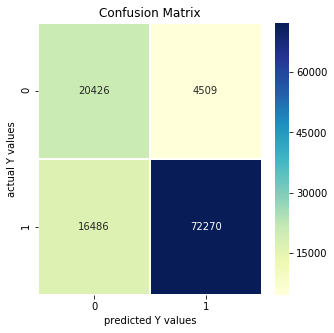

17.204745292663574 seconds


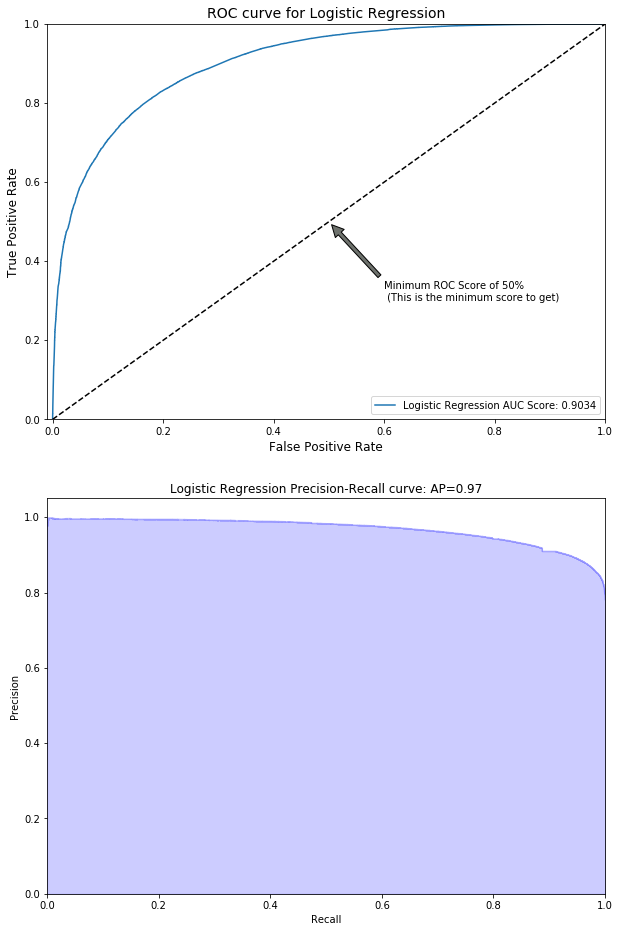

In [48]:
# Logistic Regression Ridge technique
lr = linear_model.LogisticRegression(penalty = 'l2', C = 10)
run_model(lr, X_train_s, y_train_s, X_test_tfidf, y_test, 1, 'Tf-idf', 'Balanced')
# plot ROC curve for Logistic Regression
run_roc_auc(lr, 'Logistic Regression', X_test_tfidf, y_test, 1)



## Logistic Regression TF-IDF Features (Original Data)


 ---------------------------------------- 
 LogisticRegression 
 ----------------------------------------
Accuracy Score: 0.8726196444749365
10 Folds Cross Validation Score Statistics: 0.87065 (+/- 0.00279)
              precision    recall  f1-score   support

    positive       0.79      0.57      0.66     24935
    negative       0.89      0.96      0.92     88756

    accuracy                           0.87    113691
   macro avg       0.84      0.76      0.79    113691
weighted avg       0.87      0.87      0.86    113691



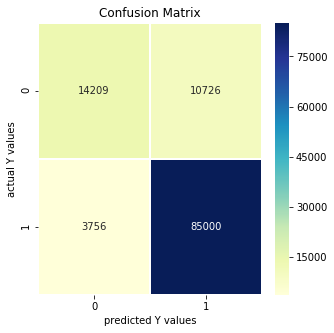

48.64486598968506 seconds


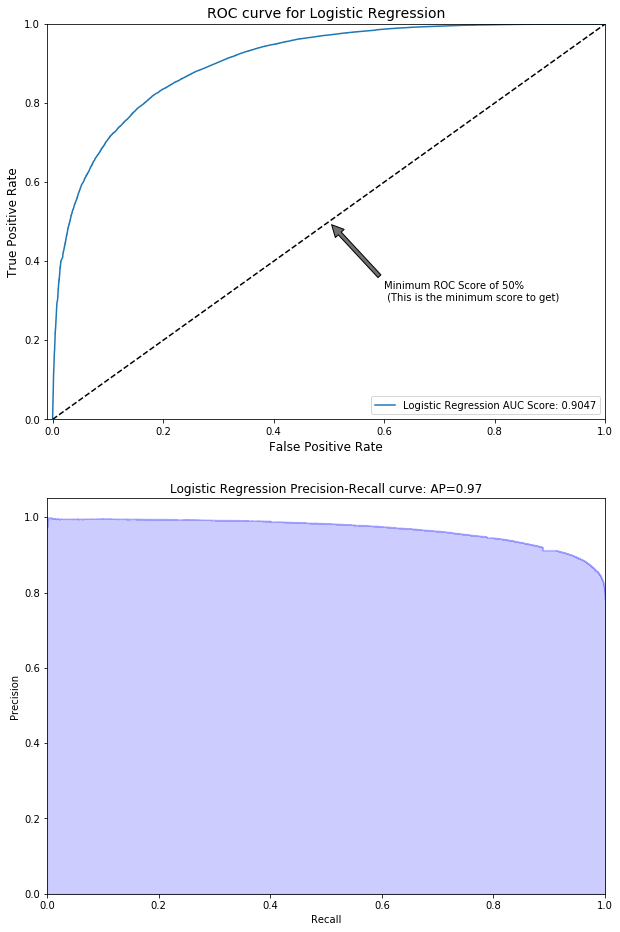

In [49]:
# Logistic Regression Ridge technique
lr2 = linear_model.LogisticRegression(penalty = 'l2', C = 10)
run_model(lr2, X_train_tfidf, y_train, X_test_tfidf, y_test, 2, 'Tf-idf', 'Original')
# plot ROC curve for Logistic Regression
run_roc_auc(lr2, 'Logistic Regression', X_test_tfidf, y_test, 2)



## Logistic Regression: BoW Features (Original Data)


 ---------------------------------------- 
 LogisticRegression 
 ----------------------------------------
Accuracy Score: 0.8725668698489766
10 Folds Cross Validation Score Statistics: 0.87037 (+/- 0.00315)
              precision    recall  f1-score   support

    positive       0.80      0.56      0.66     24935
    negative       0.89      0.96      0.92     88756

    accuracy                           0.87    113691
   macro avg       0.84      0.76      0.79    113691
weighted avg       0.87      0.87      0.86    113691



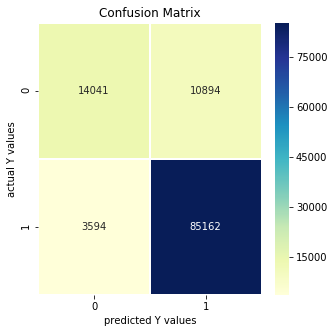

73.28010106086731 seconds


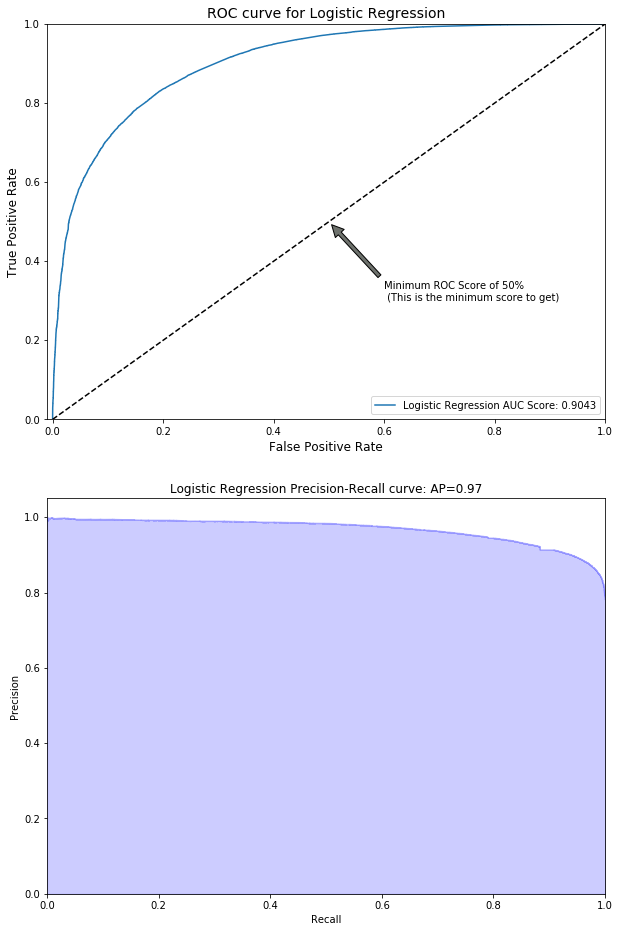

In [50]:
run_model(lr2, X_train_counts, y_train, X_test_counts, y_test, 3, 'BoW', 'Original')
# plot ROC curve for Logistic Regression
run_roc_auc(lr2, 'Logistic Regression', X_test_counts, y_test, 3)

## Logistic Regression: BoW Features (Balanced Data)


 ---------------------------------------- 
 LogisticRegression 
 ----------------------------------------
Accuracy Score: 0.8127028524685331
10 Folds Cross Validation Score Statistics: 0.77816 (+/- 0.03006)
              precision    recall  f1-score   support

    positive       0.55      0.83      0.66     24935
    negative       0.94      0.81      0.87     88756

    accuracy                           0.81    113691
   macro avg       0.75      0.82      0.77    113691
weighted avg       0.86      0.81      0.82    113691



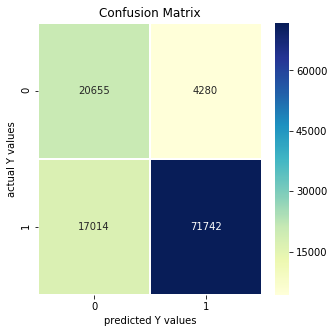

27.441946744918823 seconds


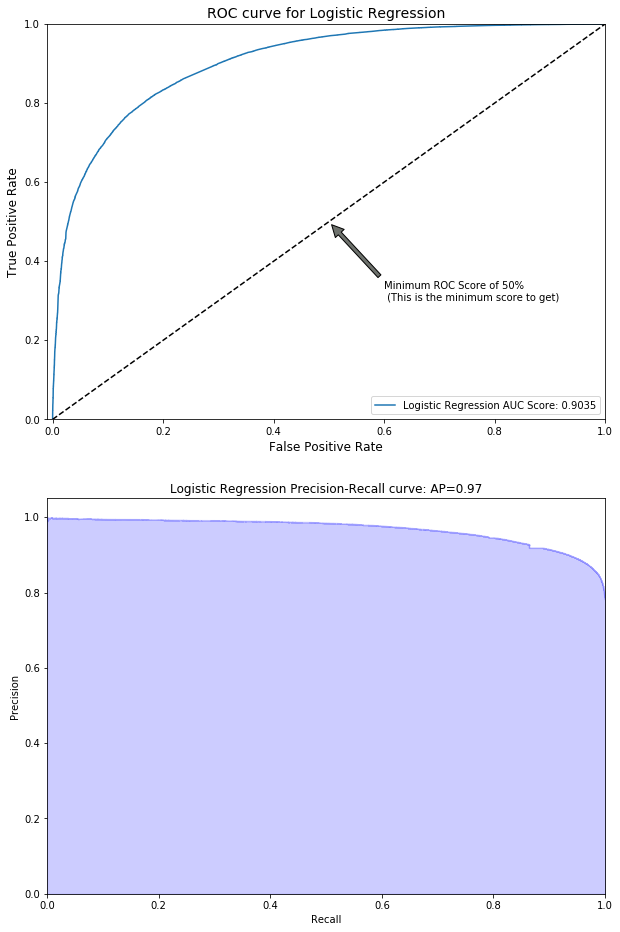

In [51]:
run_model(lr2, X_train_bow_s, y_train_bow_s, X_test_counts, y_test, 4, 'BoW', 'Balanced')
# plot ROC curve for Logistic Regression
run_roc_auc(lr2, 'Logistic Regression', X_test_counts, y_test, 4)

## Feature and Dataset selection

In [52]:
# see the report
report

,Model,Dataset,Features,n_train,Cross_Val_Mean,Cross_Val_Std,Test_Accuracy,AUC Score,Recall,Precision,F1
1,LogisticRegression,Balanced,Tf-idf,199484,0.774288,0.00821115,0.815333,0.903351,0.814255,0.941273,0.873169
2,LogisticRegression,Original,Tf-idf,454763,0.870651,0.0013929,0.87262,0.904651,0.957682,0.887951,0.921499
3,LogisticRegression,Original,BoW,454763,0.870365,0.0015747,0.872567,0.90427,0.959507,0.886587,0.921607
4,LogisticRegression,Balanced,BoW,199484,0.778157,0.0150295,0.812703,0.903513,0.808306,0.943701,0.870772


Models with `TF-IDF` features run faster and give better accuracy than those of BoW

Judging by cross-validation means, balanced datasets are more tend to overfit than the original one. And if consider F1 and AUC scores for the models trained on original datasets, we can say that the TF-IDF features are good to continue testing other algorithms on. 


In [53]:
!pip install eli5
import eli5


     |████████████████████████████████| 102kB 21.2MB/s 


In [54]:
eli5.show_weights(lr, vec=count_vect, top=50)

Weight?,Feature
+8.462,heaven
+7.938,great hot
+7.254,one best
+6.919,new favorite
+6.668,excellent
+6.543,get enough
+6.512,go wrong
+6.184,delish
+6.159,finally
+6.138,doesnt get


# Random Forest Classifier


 ---------------------------------------- 
 RandomForestClassifier 
 ----------------------------------------
Accuracy Score: 0.8735607919712203
10 Folds Cross Validation Score Statistics: 0.86918 (+/- 0.00520)
              precision    recall  f1-score   support

    positive       0.75      0.63      0.69     24935
    negative       0.90      0.94      0.92     88756

    accuracy                           0.87    113691
   macro avg       0.83      0.79      0.80    113691
weighted avg       0.87      0.87      0.87    113691



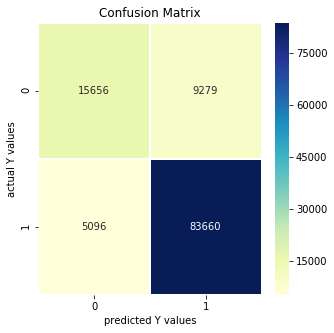

230.58555603027344 seconds


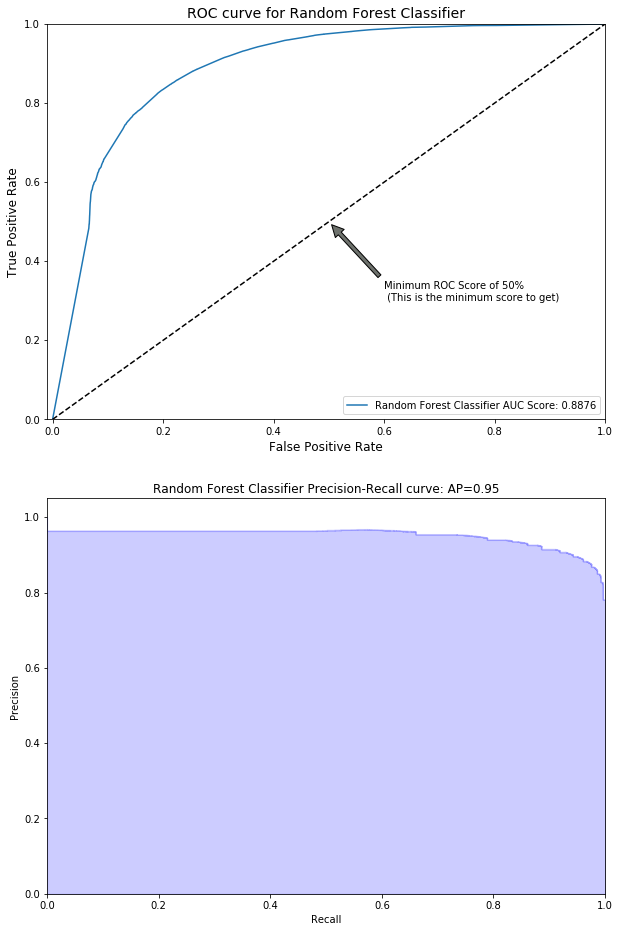

In [55]:
rfc = ensemble.RandomForestClassifier()
run_model(rfc, X_train_tfidf[:100000], y_train[:100000], X_test_tfidf, y_test, 5, 'Tf-idf', 'Original')
run_roc_auc(rfc, 'Random Forest Classifier', X_test_tfidf, y_test, 5)

# XGBoost


 ---------------------------------------- 
 XGBClassifier 
 ----------------------------------------
Accuracy Score: 0.8102400365904073
10 Folds Cross Validation Score Statistics: 0.81009 (+/- 0.00332)
              precision    recall  f1-score   support

    positive       0.91      0.15      0.26     24935
    negative       0.81      1.00      0.89     88756

    accuracy                           0.81    113691
   macro avg       0.86      0.57      0.57    113691
weighted avg       0.83      0.81      0.75    113691



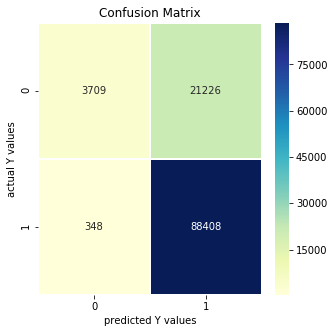

200.46843194961548 seconds


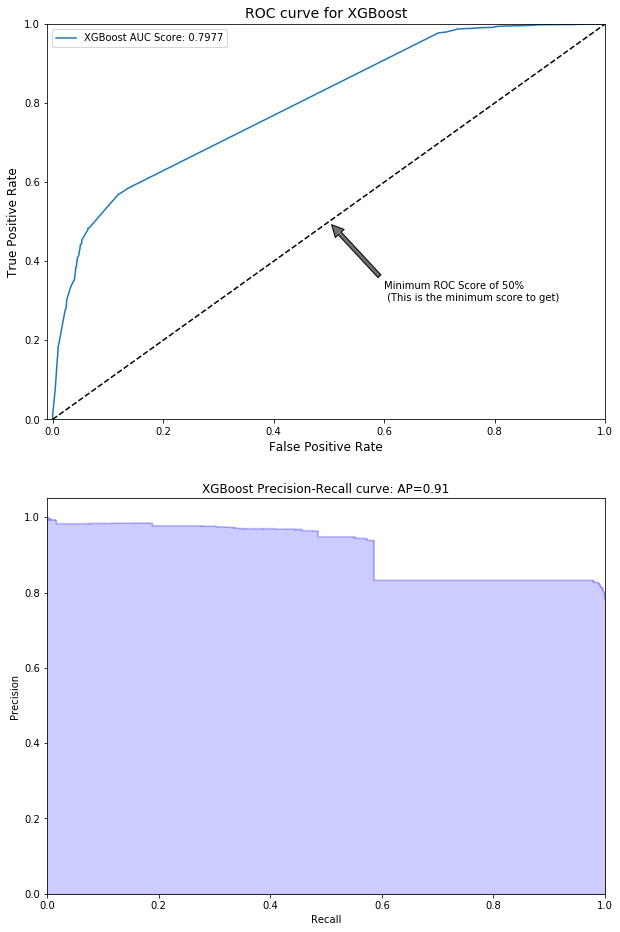

In [56]:
import xgboost as xgb
xgb = xgb.XGBClassifier()

run_model(xgb, X_train_tfidf, y_train, X_test_tfidf, y_test, 6, 'Tf-idf', 'Original')
run_roc_auc(xgb, 'XGBoost', X_test_tfidf, y_test, 6)

# LightGBM Classifier


 ---------------------------------------- 
 LGBMClassifier 
 ----------------------------------------
Accuracy Score: 0.8528731385949635
10 Folds Cross Validation Score Statistics: 0.85107 (+/- 0.00301)
              precision    recall  f1-score   support

    positive       0.86      0.39      0.54     24935
    negative       0.85      0.98      0.91     88756

    accuracy                           0.85    113691
   macro avg       0.86      0.69      0.73    113691
weighted avg       0.85      0.85      0.83    113691



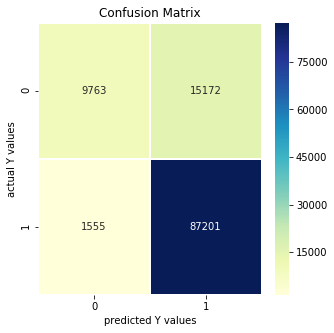

284.083952665329 seconds


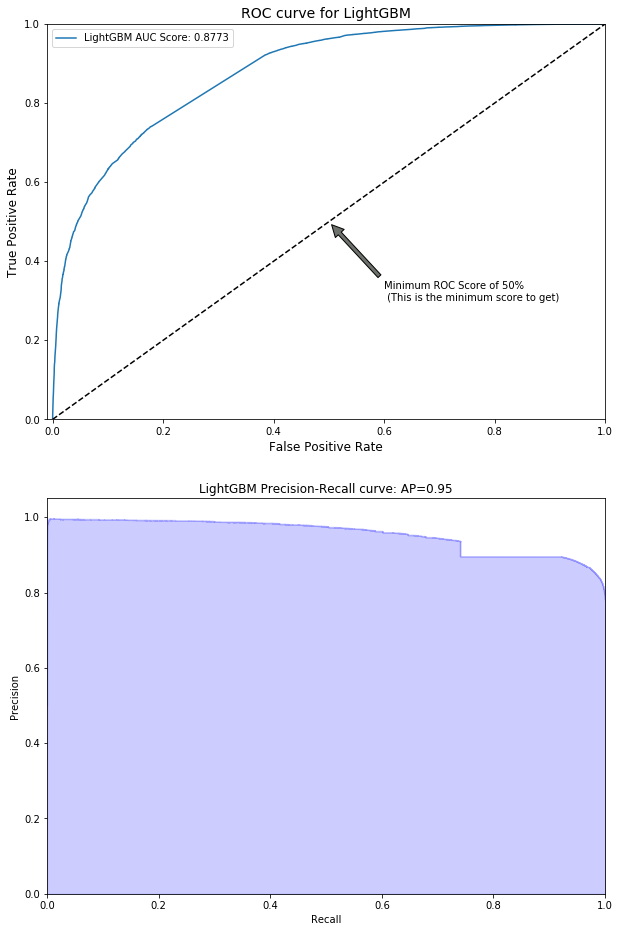

In [57]:
import lightgbm as lgb 
lgb = lgb.LGBMClassifier(silent=False)

run_model(lgb, X_train_tfidf, y_train, X_test_tfidf, y_test, 7, 'Tf-idf', 'Original')
run_roc_auc(lgb, 'LightGBM', X_test_tfidf, y_test, 7)

# Supervised ML Model Selection


In [58]:
report

,Model,Dataset,Features,n_train,Cross_Val_Mean,Cross_Val_Std,Test_Accuracy,AUC Score,Recall,Precision,F1
1,LogisticRegression,Balanced,Tf-idf,199484,0.774288,0.00821115,0.815333,0.903351,0.814255,0.941273,0.873169
2,LogisticRegression,Original,Tf-idf,454763,0.870651,0.0013929,0.87262,0.904651,0.957682,0.887951,0.921499
3,LogisticRegression,Original,BoW,454763,0.870365,0.0015747,0.872567,0.90427,0.959507,0.886587,0.921607
4,LogisticRegression,Balanced,BoW,199484,0.778157,0.0150295,0.812703,0.903513,0.808306,0.943701,0.870772
5,RandomForestClassifier,Original,Tf-idf,100000,0.86918,0.00259915,0.873561,0.887592,0.942584,0.90016,0.920884
6,XGBClassifier,Original,Tf-idf,454763,0.810086,0.001659,0.81024,0.797713,0.996079,0.806392,0.891255
7,LGBMClassifier,Original,Tf-idf,454763,0.85107,0.00150415,0.852873,0.877306,0.98248,0.851797,0.912483


After running four supervised algorithms, we can observe that the fastest model and the model with the highest AUC score is Logistic Regression with tf-idf features on the full dataset. However, thought the Random Forest Classifier runs longer, it resulted in the highest accuracy score. 
Since we work with imbalanced data, the importance of AUC score is more than the accuracy score. Additionally, Logistic Regression gas one more '+' being the fastest. 
**So, the chosen model is Logistic Regression.**

# Deep Learning: Building Models with Keras


In [59]:
from keras.models import Sequential
from keras.layers import Dense, Bidirectional, Flatten, LSTM, Conv1D, MaxPooling1D, Embedding, Activation, Dropout
from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
from keras.callbacks import EarlyStopping, ReduceLROnPlateau 
from keras.layers import Dense, LSTM, Embedding, Activation, Dropout
from keras.constraints import max_norm
from keras.utils.vis_utils import plot_model
from keras.utils import np_utils
from keras.optimizers import RMSprop, SGD
from sklearn.utils import class_weight
import tensorflow as tf


Using TensorFlow backend.


In [0]:
def plot_confusion(model, X_test, y_test):
  predictions = model.predict_classes(X_test, batch_size = 10, verbose  = 0)
  y_pred = predictions[:,0]

  cm = confusion_matrix(y_test, y_pred)
  target_names = ['positive', 'negative']


  # plot confusion matrix
  sns.heatmap(cm, annot = True, linewidths=0.5, cmap = 'YlGnBu',fmt = ".0f")
  plt.show()

  print(classification_report(y_test, y_pred, target_names=target_names))

In [0]:
def auc_roc(y_true, y_pred):
    # any tensorflow metric
    value, update_op = tf.contrib.metrics.streaming_auc(y_pred, y_true)

    # find all variables created for this metric
    metric_vars = [i for i in tf.local_variables() if 'auc_roc' in i.name.split('/')[1]]

    # Add metric variables to GLOBAL_VARIABLES collection.
    # They will be initialized for new session.
    for v in metric_vars:
        tf.add_to_collection(tf.GraphKeys.GLOBAL_VARIABLES, v)

    # force to update metric values
    with tf.control_dependencies([update_op]):
        value = tf.identity(value)
        return value

In [0]:
def aucroc(y_true, y_pred):
    return tf.py_func(roc_auc_score, (y_true, y_pred), tf.double)

## Simple 2 Layers DNN

In [63]:
input_dim = X_train_counts.shape[1]

# initialize model
model = Sequential()
model.add(Dense(512, input_dim=input_dim, activation='relu', kernel_constraint=max_norm(3), bias_constraint=max_norm(3)))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=RMSprop(),
              loss='binary_crossentropy',
              metrics=['accuracy', auc_roc])

model.summary()

W0718 03:47:11.106609 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0718 03:47:11.153284 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0718 03:47:11.160203 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0718 03:47:11.201554 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0718 03:47:11.209321 140281833625472 deprecation_wrappe

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 512)               2560512   
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 513       
Total params: 2,561,025
Trainable params: 2,561,025
Non-trainable params: 0
_________________________________________________________________


In [0]:
plot_model(model, to_file='DNN_plot.png', show_shapes=True, show_layer_names=True)

In [0]:
# define custom callback 
my_callbacks = [EarlyStopping(monitor='auc_roc', patience=300, verbose=1, mode='max')]

In [66]:
# fit the model
dnn_history = model.fit(X_train_counts[:-100], y_train[:-100],
          epochs=10,
          verbose=1,
          validation_split=0.3,
          shuffle=True,
          batch_size=128,
          callbacks=my_callbacks)

W0718 03:47:13.573627 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.



Train on 318264 samples, validate on 136399 samples
Epoch 1/10
318264/318264 [==============================] - 26s 82us/step - loss: 0.3358 - acc: 0.8614 - auc_roc: 0.8568 - val_loss: 0.3266 - val_acc: 0.8674 - val_auc_roc: 0.8793
Epoch 2/10
318264/318264 [==============================] - 22s 69us/step - loss: 0.3230 - acc: 0.8681 - auc_roc: 0.8823 - val_loss: 0.3243 - val_acc: 0.8660 - val_auc_roc: 0.8835
Epoch 3/10
318264/318264 [==============================] - 22s 69us/step - loss: 0.3223 - acc: 0.8681 - auc_roc: 0.8844 - val_loss: 0.3244 - val_acc: 0.8680 - val_auc_roc: 0.8850
Epoch 4/10
318264/318264 [==============================] - 22s 68us/step - loss: 0.3220 - acc: 0.8679 - auc_roc: 0.8855 - val_loss: 0.3238 - val_acc: 0.8658 - val_auc_roc: 0.8858
Epoch 5/10
318264/318264 [==============================] - 22s 69us/step - loss: 0.3219 - acc: 0.8686 - auc_roc: 0.8862 - val_loss: 0.3248 - val_acc: 0.8651 - val_auc_roc: 0.8863
Epoch 6/10
318264/318264 [======================

In [67]:
# check the predicted values
dnn_predictions = model.predict_classes(X_test_counts, batch_size = 10, verbose  = 0)
dnn_predictions[:,0]

array([1, 1, 0, ..., 1, 1, 0], dtype=int32)

In [0]:
def plot_acc(model):
  
  """ This function plots model accuracy and loss scores per epochs"""
  
# plot training & validation accuracy values
  plt.plot(model.history['acc'])
  plt.plot(model.history['val_acc'])
  plt.title('Model accuracy')
  plt.ylabel('Accuracy')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.show()

# plot training & validation loss values
  plt.plot(model.history['loss'])
  plt.plot(model.history['val_loss'])
  plt.title('Model loss')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.show()

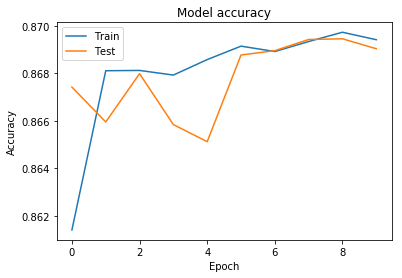

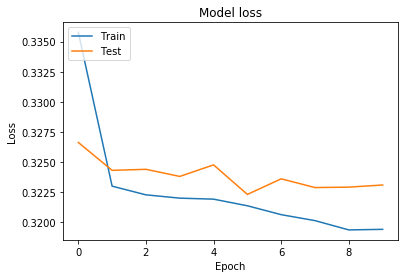

In [69]:
plot_acc(dnn_history)

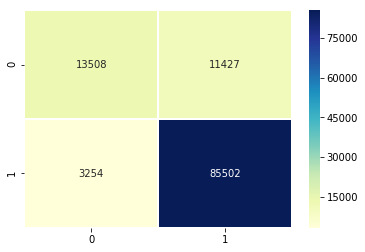

              precision    recall  f1-score   support

    positive       0.81      0.54      0.65     24935
    negative       0.88      0.96      0.92     88756

    accuracy                           0.87    113691
   macro avg       0.84      0.75      0.78    113691
weighted avg       0.87      0.87      0.86    113691



In [70]:

plot_confusion(model, X_test_counts, y_test)

In [71]:
loss, accuracy, auc = model.evaluate(X_test_counts, y_test)
report.loc[8, 'Test_Accuracy'] = accuracy
report.loc[8,'Model'] = 'DNN'
report.loc[8, 'Features'] = 'BoW'
report.loc[8, 'Dataset'] = 'Original'
report.loc[8, 'AUC Score'] = auc

113691/113691 [==============================] - 9s 82us/step


In [72]:
accuracy

0.870869286054084

## Recurrent Neural Network - LSTM

In [0]:
# setting parameters
max_words = len(count_vect.get_feature_names())+1
tok = Tokenizer(num_words=max_words)
tok.fit_on_texts(X_train)
max_seq_lenght = 150

# text to sequence
def to_sequence(x_train):
  train_sequences = tok.texts_to_sequences(x_train)
  sequences_matrix = sequence.pad_sequences(train_sequences, maxlen=max_seq_lenght)
  return sequences_matrix

X_train_sequences = to_sequence(X_train)
X_test_sequences = to_sequence(X_test)

In [74]:
rnn = Sequential()

# RNN
rnn.add(Embedding(len(count_vect.get_feature_names()) + 1,
                    64,  # Embedding size
                    input_length=max_seq_lenght))
rnn.add(LSTM(64))
rnn.add(Dense(256, name='FC1'))
rnn.add(Activation('relu'))
rnn.add(Dropout(0.2))
rnn.add(Dense(1, name = 'out_layer'))
rnn.add(Activation('sigmoid'))

rnn.compile(loss = 'binary_crossentropy', optimizer = RMSprop(), metrics = ['accuracy', auc_roc])
rnn.summary()

W0718 03:51:48.774893 140281833625472 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 150, 64)           320064    
_________________________________________________________________
lstm_1 (LSTM)                (None, 64)                33024     
_________________________________________________________________
FC1 (Dense)                  (None, 256)               16640     
_________________________________________________________________
activation_1 (Activation)    (None, 256)               0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
out_layer (Dense)            (None, 1)                 257       
_________________________________________________________________
activation_2 (Activation)    (None, 1)                 0         
Total para

In [0]:
plot_model(rnn, to_file='RNN-LSTM_plot.png', show_shapes=True, show_layer_names=True)

In [76]:
rnn_history = rnn.fit(X_train_sequences, y_train, 
        epochs=10,
        validation_split=0.3,
        shuffle=True,
        batch_size = 128,
        callbacks=my_callbacks)

Train on 318334 samples, validate on 136429 samples
Epoch 1/10
318334/318334 [==============================] - 573s 2ms/step - loss: 0.3355 - acc: 0.8591 - auc_roc: 0.8428 - val_loss: 0.3121 - val_acc: 0.8703 - val_auc_roc: 0.8821
Epoch 2/10
318334/318334 [==============================] - 563s 2ms/step - loss: 0.3060 - acc: 0.8736 - auc_roc: 0.8884 - val_loss: 0.3031 - val_acc: 0.8746 - val_auc_roc: 0.8924
Epoch 3/10
318334/318334 [==============================] - 567s 2ms/step - loss: 0.2973 - acc: 0.8775 - auc_roc: 0.8952 - val_loss: 0.2995 - val_acc: 0.8764 - val_auc_roc: 0.8974
Epoch 4/10
318334/318334 [==============================] - 565s 2ms/step - loss: 0.2889 - acc: 0.8814 - auc_roc: 0.8993 - val_loss: 0.2938 - val_acc: 0.8784 - val_auc_roc: 0.9011
Epoch 5/10
318334/318334 [==============================] - 564s 2ms/step - loss: 0.2822 - acc: 0.8845 - auc_roc: 0.9027 - val_loss: 0.2903 - val_acc: 0.8795 - val_auc_roc: 0.9041
Epoch 6/10
318334/318334 [======================

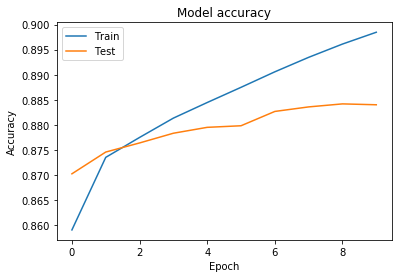

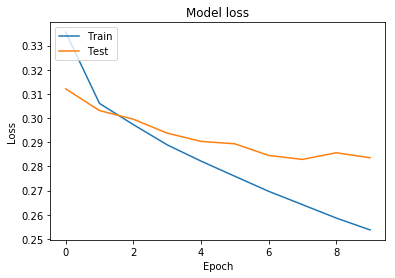

In [77]:
plot_acc(rnn_history)

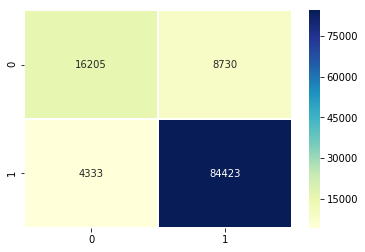

              precision    recall  f1-score   support

    positive       0.79      0.65      0.71     24935
    negative       0.91      0.95      0.93     88756

    accuracy                           0.89    113691
   macro avg       0.85      0.80      0.82    113691
weighted avg       0.88      0.89      0.88    113691



In [78]:
plot_confusion(rnn, X_test_sequences, y_test)

In [79]:
loss, accuracy, auc = rnn.evaluate(X_test_sequences, y_test)
report.loc[9, 'Test_Accuracy'] = accuracy
report.loc[9,'Model'] = 'RNN-LSTM'
report.loc[9, 'Features'] = ''
report.loc[9, 'Dataset'] = 'Original'
report.loc[9, 'AUC Score'] = auc

113691/113691 [==============================] - 283s 2ms/step


## Convolutional Neural Network

In [80]:
cnn = Sequential()
cnn.add(Embedding(len(count_vect.get_feature_names()) + 1,
                    64,  # Embedding size
                    input_length=max_seq_lenght))
cnn.add(Conv1D(64, 5, activation='relu', kernel_constraint=max_norm(1), bias_constraint=max_norm(1)))
cnn.add(MaxPooling1D(5))
cnn.add(Flatten())
cnn.add(Dense(units=64, activation='relu'))
cnn.add(Dense(units=1, activation='sigmoid'))
 
cnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy', auc_roc])
print(cnn.summary())

W0718 05:43:39.508448 140281833625472 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 150, 64)           320064    
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 146, 64)           20544     
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 29, 64)            0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1856)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 64)                118848    
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 65        
Total params: 459,521
Trainable params: 459,521
Non-trainable params: 0
_________________________________________________________________
None

In [0]:
plot_model(cnn, to_file='CNN_plot.png', show_shapes=True, show_layer_names=True)

In [82]:
cnn_history = cnn.fit(X_train_sequences, y_train, 
          epochs=10,
          batch_size=128, 
          verbose=1,
          validation_split=0.3,
          shuffle=True,
          callbacks = my_callbacks)
 

Train on 318334 samples, validate on 136429 samples
Epoch 1/10
318334/318334 [==============================] - 20s 63us/step - loss: 0.4027 - acc: 0.8254 - auc_roc: 0.7693 - val_loss: 0.3804 - val_acc: 0.8361 - val_auc_roc: 0.8144
Epoch 2/10
318334/318334 [==============================] - 17s 52us/step - loss: 0.3621 - acc: 0.8448 - auc_roc: 0.8256 - val_loss: 0.3726 - val_acc: 0.8411 - val_auc_roc: 0.8317
Epoch 3/10
318334/318334 [==============================] - 17s 52us/step - loss: 0.3404 - acc: 0.8553 - auc_roc: 0.8377 - val_loss: 0.3787 - val_acc: 0.8434 - val_auc_roc: 0.8416
Epoch 4/10
318334/318334 [==============================] - 16s 52us/step - loss: 0.3234 - acc: 0.8629 - auc_roc: 0.8458 - val_loss: 0.3829 - val_acc: 0.8446 - val_auc_roc: 0.8487
Epoch 5/10
318334/318334 [==============================] - 17s 53us/step - loss: 0.3098 - acc: 0.8687 - auc_roc: 0.8519 - val_loss: 0.3916 - val_acc: 0.8430 - val_auc_roc: 0.8542
Epoch 6/10
318334/318334 [======================

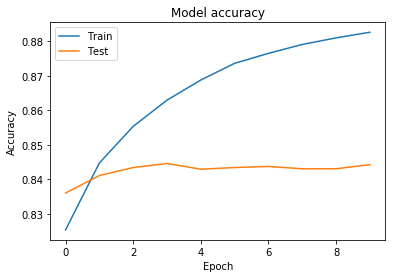

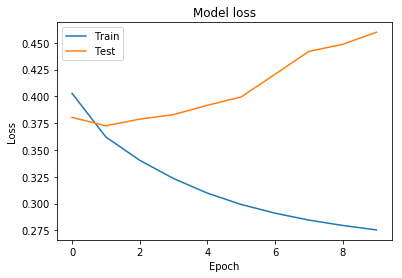

In [83]:
plot_acc(cnn_history)

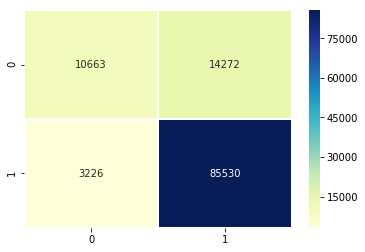

              precision    recall  f1-score   support

    positive       0.77      0.43      0.55     24935
    negative       0.86      0.96      0.91     88756

    accuracy                           0.85    113691
   macro avg       0.81      0.70      0.73    113691
weighted avg       0.84      0.85      0.83    113691



In [84]:
plot_confusion(cnn, X_test_sequences, y_test)

In [85]:
loss, accuracy, auc = cnn.evaluate(X_test_sequences, y_test)
report.loc[10, 'Test_Accuracy'] = accuracy
report.loc[10,'Model'] = 'CNN'
report.loc[10, 'Features'] = ''
report.loc[10, 'Dataset'] = 'Original'
report.loc[10, 'AUC Score'] = auc

113691/113691 [==============================] - 9s 75us/step


# Model Evaluation

## Metrics: AUC Score
Since the dataset class distribution is not equally distributed, `Accuracy Score` cannot be reliable metric for model evaluation. In other words, we have accuracy paradox, 

ROC curve does not measure well for imbalanced data. ROC curve plot False Positive Rate vs. True Positive Rate. Because TPR only depends on positives, ROC curves do not measure the effect of negatives. The area under ROC curve (AUC) assesses overall classification performance. AUC does not place more emphasis on one class over the other, so it does reflect the minority class well.

### Secondary Metric: Accuracy Score
We can choose accuracy as a secondary metric in case we have very close AUC scores for different models.



In [94]:
report[['Model', 'Features', 'Test_Accuracy', 'AUC Score']].sort_values(by = ['AUC Score'], ascending  = False)

,Model,Features,Test_Accuracy,AUC Score
9,RNN-LSTM,,0.885101,0.914446
2,LogisticRegression,Tf-idf,0.87262,0.904651
3,LogisticRegression,BoW,0.872567,0.90427
4,LogisticRegression,BoW,0.812703,0.903513
1,LogisticRegression,Tf-idf,0.815333,0.903351
8,DNN,BoW,0.870869,0.888176
5,RandomForestClassifier,Tf-idf,0.873561,0.887592
7,LGBMClassifier,Tf-idf,0.852873,0.877306
10,CNN,,0.846092,0.868406
6,XGBClassifier,Tf-idf,0.81024,0.797713


From a first look, RNN model is the most accurate performer among DL models with the highest overall AUC and Accuracy scores. However, this model is the longest-running and compared to others, it's not computationally efficient.

The second-best performer is LogisticRegression with Ridge regularization. The accuracy difference between RNN and LogisticRegression is very little. But the second-place algorithm runs 107 times faster than RNN model which might be a key detail in selecting the winner. 

# Conclusion
To conclude, LogisticRegression model with Tf-Idf features is the winner of this project, however,  with more powerful computer we would be able to train more epochs and increase the accuracy of the model for RNN.

## Future improvement
 - Oversampling minority class
 - Unsupervised feature extraction (pLSA, LSA or LDA)
 - More complex RNN or CNN
 - Removing common words from summary to decrease the processing time if it would not affect model acccuracy badly.